In [1]:
import pandas as pd
import numpy as np
import os
import torch
from recbole.utils.case_study import full_sort_topk, full_sort_scores
from recbole.quick_start import load_data_and_model
from recbole.data.interaction import Interaction

#viz
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.font_manager import FontProperties
from plotly.offline import iplot
from plotly.subplots import make_subplots
import plotly.express as px
import plotly.graph_objects as go 
from joypy import joyplot
import sys  
import gc

gc.collect()
  
sys.setrecursionlimit(9000)  # original it's 3000
rootpath="../../Datasets/KuaiRec 2.0/"
image_path = './Figure/'
image_name_pref = 'KuaiRec'

In [265]:
OUTPATH = './Dataset/'
OUTNAME = 'KuaiRec_1D'

ds_all_windows = {}
for i in range(63):
    temp = pd.read_csv(f"{OUTPATH}{OUTNAME}_{i}/{OUTNAME}_{i}.csv")
    ds_all_windows[i+1] = temp
    print(f'{i+1}: {temp.shape};\t unique users #: {len(temp.user_id.unique())};\t unique items #: {len(temp.video_id.unique())};\t \
    sparsity: {1-len(temp)/(len(temp.user_id.unique())*len(temp.video_id.unique())):.3f}')

1: (915, 3);	 unique users #: 491;	 unique items #: 269;	     sparsity: 0.993
2: (2939, 3);	 unique users #: 1086;	 unique items #: 377;	     sparsity: 0.993
3: (6620, 3);	 unique users #: 1344;	 unique items #: 498;	     sparsity: 0.990
4: (12094, 3);	 unique users #: 1394;	 unique items #: 591;	     sparsity: 0.985
5: (21031, 3);	 unique users #: 1407;	 unique items #: 682;	     sparsity: 0.978
6: (31069, 3);	 unique users #: 1407;	 unique items #: 810;	     sparsity: 0.973
7: (43549, 3);	 unique users #: 1409;	 unique items #: 915;	     sparsity: 0.966
8: (57065, 3);	 unique users #: 1410;	 unique items #: 1009;	     sparsity: 0.960
9: (69957, 3);	 unique users #: 1410;	 unique items #: 1086;	     sparsity: 0.954
10: (85422, 3);	 unique users #: 1410;	 unique items #: 1159;	     sparsity: 0.948
11: (97733, 3);	 unique users #: 1410;	 unique items #: 1243;	     sparsity: 0.944
12: (111357, 3);	 unique users #: 1411;	 unique items #: 1320;	     sparsity: 0.940
13: (130717, 3);	 unique

In [207]:
DF_SECD = pd.read_excel('./Model/HyperTuning_KuaiRec.xlsx')
DF_SECD['DataIndex'] = DF_SECD['day']+1
DF_SECD.head(1)
#CAT_COL_SECD = 'DataIndex'
#TARGET_COL_SECD = 'ndcg_10'

,day,embedding_size,learning_rate,ndcg_10,recall_10,DataIndex
0,0,64,0.01,0.0514,0.0882,1


In [354]:
font_size = 15
marker_size = 3
line_size = 3
dtick_length = 1
legend_font_size = 15

# Part 0: Some viz for whole population

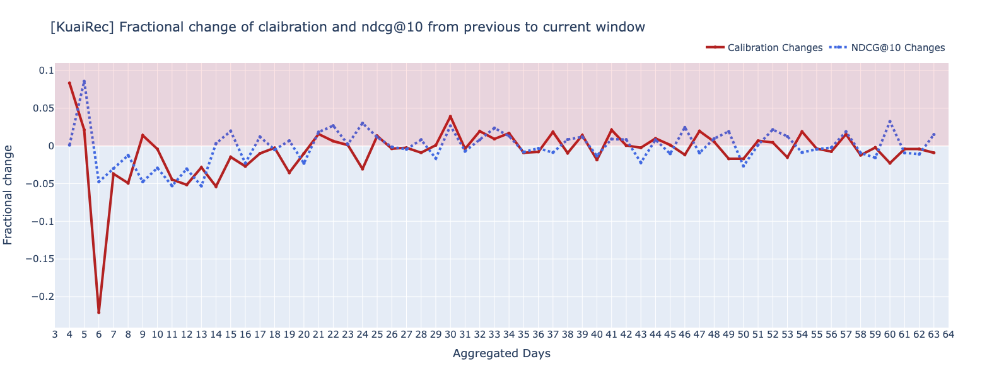

In [347]:
miscalibration_chg = DF_MEAN['value'].pct_change().tolist()[1:]
calibration_chg = [-v for v in miscalibration_chg]
ndcg_chg = DF_SECD['ndcg_10'].pct_change().tolist()[1:]

ys = [calibration_chg, ndcg_chg]
names = ['Calibration Changes', 'NDCG@10 Changes']
colors = ['firebrick','royalblue'] 
dashes = ['solid','dot']

fig = go.Figure()

fig.add_trace(go.Scatter(
    #x = list(range(2,64)),
    x = list(range(4,64)),
    y = ys[0][2:],
    mode='lines+markers',
    name=names[0],
    
    marker = dict(
        size=marker_size
    ),
    
    line = dict(
        color = colors[0],
        width=line_size,
        dash=dashes[0]
    )
))

fig.add_trace(go.Scatter(
    #x = list(range(2,64)),
    x = list(range(4,64)),
    y = ys[1][2:],
    mode='lines+markers',
    name=names[1],
    
    marker = dict(
        size=marker_size
    ),
    
    line = dict(
        color = colors[1],
        width=line_size,
        dash=dashes[1]
    )
))

fig.add_hrect(y0=0, y1=0.11, line_width=0, fillcolor="red", opacity=0.1)

fig.update_layout(
    height=600, width=1300, 
    #title=f'Miscalibration of user segments by different {GROUP_COL}', # Title
    title=f'[KuaiRec] Fractional change of claibration and ndcg@10 from previous to current window', # Title
    xaxis_title='Aggregated Days', # y-axis name
    yaxis_title='Fractional change', # x-axis name
    #xaxis_tickangle=45,  # Set the x-axis label angle
    showlegend=True,     # Display the legend
    xaxis = dict(
        tickmode = 'linear',
        dtick =dtick_length,
        range=[3,64]
    ),
    legend=dict(
        orientation="h",
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1,
        font=dict(
            size=legend_font_size,
        ),
    ),
    font=dict(size=font_size,)
)

iplot(fig)
image_name = 'FractionalChange'
fig.write_image(f"{image_path}{image_name_pref}_{image_name}.png", width=1400, height=700)

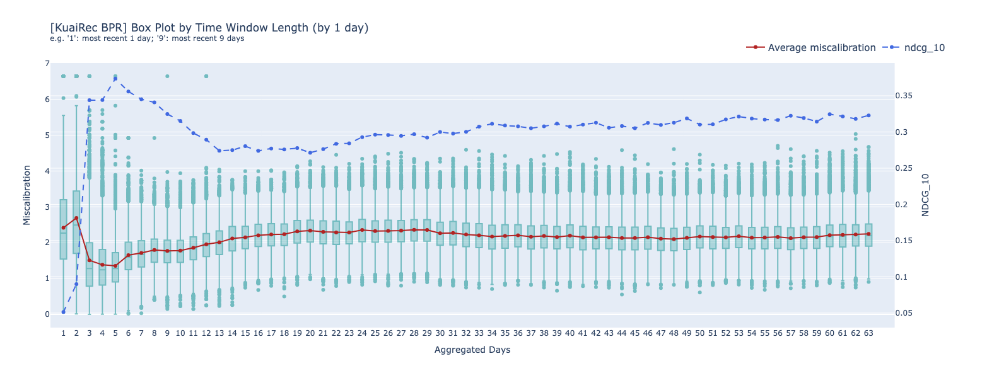

In [348]:
DF = agg_across_1d_df
CAT_COL = 'DataIndex'
TARGET_COL = 'miscalibration'
DF_MEAN = DF[[CAT_COL,TARGET_COL]].groupby(CAT_COL, as_index=False).mean().melt(id_vars=CAT_COL)

CAT_COL_SECD = 'DataIndex'
TARGET_COL_SECD = 'ndcg_10'

text = "[KuaiRec BPR] Box Plot by Time Window Length (by 1 day) <br><sup>e.g. '1': most recent 1 day; '9': most recent 9 days</sup>"
cat_order = sorted(DF.DataIndex.unique())
#c = ['hsl('+str(h)+',50%'+',50%)' for h in np.linspace(0, 360, len(cat_order))]#
#c = ['hsl(120'+',50%'+',50%)' for h in np.linspace(0, 360, len(cat_order))]
c = ['darkcyan' for  h in np.linspace(0, 360, len(cat_order))]
fig = make_subplots(specs=[[{"secondary_y": True}]])                                             

for _i,_c in zip(cat_order,c):
    fig.add_trace(go.Box(
        y = DF[DF[CAT_COL]==_i][TARGET_COL],
        opacity=0.5,
        name = str(_i),
        marker_color=_c, showlegend=False
    ), secondary_y=False)

trace_mean = go.Scatter(
    x=DF_MEAN[CAT_COL],
    y=DF_MEAN['value'],
    name='Average miscalibration',
    mode='lines+markers',
    line = dict(color='firebrick')
)
fig.add_trace(trace_mean, secondary_y=False)

trace_secd = go.Scatter(
    x = DF_SECD[CAT_COL_SECD],
    y = DF_SECD[TARGET_COL_SECD],
    name = TARGET_COL_SECD,
    mode='lines+markers',
    line=dict(color='royalblue',
             dash='dash')
)
fig.add_trace(trace_secd, secondary_y=True)

fig.update_layout(
    height=600, width=1300, 
    title_text=text,
    xaxis_title='Aggregated Days',
    yaxis_title='Miscalibration',
    yaxis2_title='NDCG_10',
    legend=dict(
        orientation="h",
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1,
        font=dict(
            size=legend_font_size,
        )),
    xaxis = dict(
        tickmode = 'linear',
        dtick = dtick_length,
        range=[-1,64]
    ),
)
iplot(fig)

image_name = 'FullMiscalibration'
fig.write_image(f"{image_path}{image_name_pref}_{image_name}.png")

# Part 1: User Segment

    > via user activity degree
    > via user profile entropy

## 1.1 User activity degree and user entropy

    --> via three activity degree (high-mid-low)

In [4]:
activity_all_windows = {i:ds.groupby('user_id').size().reset_index(name='activity_counts')
                       for i, ds in ds_all_windows.items()}

In [5]:
CAT_COL = 'feat'
ITEM_COL = 'video_id'
item_categories = pd.read_csv(rootpath + "data/item_categories.csv")
item_categories["feat"] = item_categories["feat"].map(eval)

class Item:
    """
    Data holder for our item.
    
    Parameters
    ----------
    id : int

    cat : dict[str, float]
        The item/movie's genre distribution, where the key
        represents the genre and value corresponds to the
        ratio of that genre.

    score : float
        Score for the item, potentially generated by some
        recommendation algorithm.
    """
    def __init__(self, _id, cats):
        self.id = _id
        self.cats = cats

    def __repr__(self):
        return f"{self.id}: {self.cats}"


def create_item_mapping(df_item, item_col, cat_col):
    """Create a dictionary of item id to Item lookup."""
    item_mapping = {}
    for row in df_item.itertuples():
        item_id = getattr(row, item_col)
        item_cat = getattr(row, cat_col)

        cat_ratio = 1. / len(item_cat)
        item_cat = {cat: cat_ratio for cat in item_cat}

        item = Item(item_id, item_cat)
        item_mapping[item_id] = item

    return item_mapping

item_cat_mapping = create_item_mapping(item_categories, ITEM_COL, CAT_COL)
item_cat_mapping[1]

1: {27: 0.5, 9: 0.5}

In [6]:
def compute_cats_distr(items, item_cat_mapping):
    """Compute the genre distribution for a given list of items."""
    distr = {}
    for item in items:
        for cat, score in item_cat_mapping[item].cats.items():
            cat_score = distr.get(cat, 0.)
            distr[cat] = cat_score + score

    # we normalize the summed up probability so it sums up to 1
    # and round it to three decimal places, adding more precision
    # doesn't add much value and clutters the output
    for cat, cat_score in distr.items():
        normed_cat_score = cat_score / len(items)
        distr[cat] = normed_cat_score

    return distr

def compute_kl_divergence(interacted_distr, reco_distr, alpha=0.01):
    """
    KL (p || q), the lower the better.

    alpha is not really a tuning parameter, it's just there to make the
    computation more numerically stable.
    """
    kl_div = 0.
    for genre, score in interacted_distr.items():
        reco_score = reco_distr.get(genre, 0.)
        reco_score = (1 - alpha) * reco_score + alpha * score
        kl_div += score * np.log2(score / reco_score)

    return kl_div

def metric_calibration(ratings_s, ratings_r, users_id, item_id=ITEM_COL, item_cat_mapping=item_cat_mapping): 
    '''calculate the calibration metric
    interacted_items: input historical ratings
    reco_items: output recommendation list
    item_cat_mapping: Compute the genre distribution for a given list of Items.'''
    
    output_dict = dict()
    inter_users_id = ratings_s.user_id.unique().tolist()
    
    if len(users_id)==len(inter_users_id):
        print('users in inter and rec: consistent')
    else: 
        print('users in inter and rec: inconsistent')
    
    for user_g_id, recommended_ls in zip(users_id,ratings_r):
        #print('user_id', user_g_id)
        interact_df = ratings_s[ratings_s.user_id == int(user_g_id)]
        #interact_ls = interact_df.item_id.unique().tolist()
        interact_ls = interact_df[item_id].tolist()
        
        interact_dist = compute_cats_distr(interact_ls, item_cat_mapping)

        recommended_ls = list(map(int, recommended_ls))
        recommended_dist = compute_cats_distr(recommended_ls, item_cat_mapping)

        user_g_cm = compute_kl_divergence(interact_dist, recommended_dist)
        output_dict[int(user_g_id)] = user_g_cm

    output_df = pd.DataFrame.from_dict(output_dict, orient='index')
     
    #output_df = output_df.reset_index()
    #output_df = output_df.rename(columns={"index": "user_id"})

    return output_dict, output_df


In [7]:
import numpy as np
import torch

from recbole.data.interaction import Interaction


@torch.no_grad()
def full_sort_scores_mod(uid_series, model, test_data, device=None):
    """Calculate the scores of all items for each user in uid_series.

    Note:
        The score of [pad] and history items will be set into -inf.

    Args:
        uid_series (numpy.ndarray or list): User id series.
        model (AbstractRecommender): Model to predict.
        test_data (FullSortEvalDataLoader): The test_data of model.
        device (torch.device, optional): The device which model will run on. Defaults to ``None``.
            Note: ``device=None`` is equivalent to ``device=torch.device('cpu')``.

    Returns:
        torch.Tensor: the scores of all items for each user in uid_series.
    """
    device = device or torch.device("cpu")
    uid_series = torch.tensor(uid_series)
    uid_field = test_data.dataset.uid_field
    dataset = test_data.dataset
    model.eval()

    if not test_data.is_sequential:
        input_interaction = dataset.join(Interaction({uid_field: uid_series}))
        history_item = test_data.uid2history_item[list(uid_series)]
        ######### mod begin ########
        print(f"Before mod: {len(uid_series)} and {len(history_item)}")
        history_item,uid_series = zip(*((x,y) for x,y in zip(history_item,uid_series) if type(x) != type(None)))
        print(f"After mod: {len(uid_series)} and {len(history_item)}")
        ########## mod end ########
        history_row = torch.cat(
            [torch.full_like(hist_iid, i) for i, hist_iid in enumerate(history_item)]
        )
        history_col = torch.cat(list(history_item))
        history_index = history_row, history_col
    else:
        _, index = (dataset.inter_feat[uid_field] == uid_series[:, None]).nonzero(
            as_tuple=True
        )
        input_interaction = dataset[index]
        history_index = None

    # Get scores of all items
    input_interaction = input_interaction.to(device)
    try:
        scores = model.full_sort_predict(input_interaction)
    except NotImplementedError:
        input_interaction = input_interaction.repeat_interleave(dataset.item_num)
        input_interaction.update(
            test_data.dataset.get_item_feature().to(device).repeat(len(uid_series))
        )
        scores = model.predict(input_interaction)

    scores = scores.view(-1, dataset.item_num)
    scores[:, 0] = -np.inf  # set scores of [pad] to -inf
    if history_index is not None:
        scores[history_index] = -np.inf  # set scores of history items to -inf

    return scores


def full_sort_topk_mod(uid_series, model, test_data, k, device=None):
    """Calculate the top-k items' scores and ids for each user in uid_series.

    Note:
        The score of [pad] and history items will be set into -inf.

    Args:
        uid_series (numpy.ndarray): User id series.
        model (AbstractRecommender): Model to predict.
        test_data (FullSortEvalDataLoader): The test_data of model.
        k (int): The top-k items.
        device (torch.device, optional): The device which model will run on. Defaults to ``None``.
            Note: ``device=None`` is equivalent to ``device=torch.device('cpu')``.

    Returns:
        tuple:
            - topk_scores (torch.Tensor): The scores of topk items.
            - topk_index (torch.Tensor): The index of topk items, which is also the internal ids of items.
    """
    scores = full_sort_scores_mod(uid_series, model, test_data, device)
    return torch.topk(scores, k)


In [8]:
# check the label distribution over the days 
# each user's profile entropy 

def compute_profile_entropy(items, item_cat_mapping):
    """Compute the genre distribution for a given list of items -- profile entropy."""
    return_value = 0
    profile_distr = compute_cats_distr(items, item_cat_mapping)
    profile_distr_sum = sum(profile_distr.values())
    
    for genre, score in profile_distr.items():
        if score != 0:
            score = score/profile_distr_sum
            return_value += score * np.log2(score)
    
    return -return_value

### [a1] explore the degree threshold. 

    > check the distribution for each time window first. 
    > via proportion, evenly distributed? 
    
    **NOTE: based on the exploration, segment the users into 5 portions mainly via population proportion.**

In [3]:
activity_all_windows[1].head()

,user_id,counts
0,19,2
1,24,2
2,37,3
3,64,1
4,97,1


In [7]:
for i, ds in activity_all_windows.items():
    print('\n',i)
    print(f'sum \t {ds.counts.sum()}')
    print(ds.counts.describe())


 1
sum 	 915
count    491.000000
mean       1.863544
std        1.603477
min        1.000000
25%        1.000000
50%        1.000000
75%        2.000000
max       14.000000
Name: counts, dtype: float64

 2
sum 	 2939
count    1086.000000
mean        2.706262
std         2.350664
min         1.000000
25%         1.000000
50%         2.000000
75%         3.000000
max        24.000000
Name: counts, dtype: float64

 3
sum 	 6620
count    1344.000000
mean        4.925595
std         3.759580
min         1.000000
25%         3.000000
50%         4.000000
75%         6.000000
max        64.000000
Name: counts, dtype: float64

 4
sum 	 12094
count    1394.000000
mean        8.675753
std         5.664555
min         1.000000
25%         5.000000
50%         7.500000
75%        11.000000
max        64.000000
Name: counts, dtype: float64

 5
sum 	 21031
count    1407.000000
mean       14.947406
std         7.735681
min         1.000000
25%        10.000000
50%        14.000000
75%        19.0000

In [24]:
temp_ds = pd.DataFrame(columns=['user_id','counts','timewindow'])
temp_ds = temp_ds.astype({"user_id": int, "counts": int, "timewindow": int})
for i, ds in activity_all_windows.items():
    ds['timewindow'] = i
    temp_ds = pd.concat([temp_ds, ds])
temp_ds.head(2)

,user_id,counts,timewindow
0,19,2,1
1,24,2,1


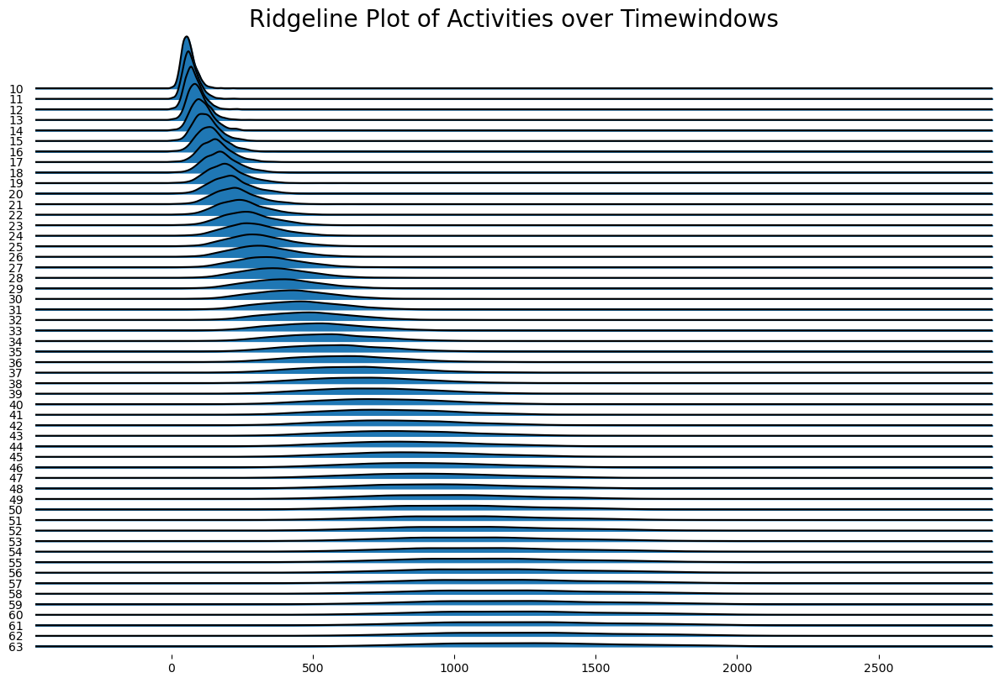

In [48]:
joyplot(
    data=temp_ds[(temp_ds.timewindow>=10)][['counts', 'timewindow']], 
    by='timewindow',
    figsize=(12, 8)
)
plt.title('Ridgeline Plot of Activities over Timewindows', fontsize=20)
plt.show()

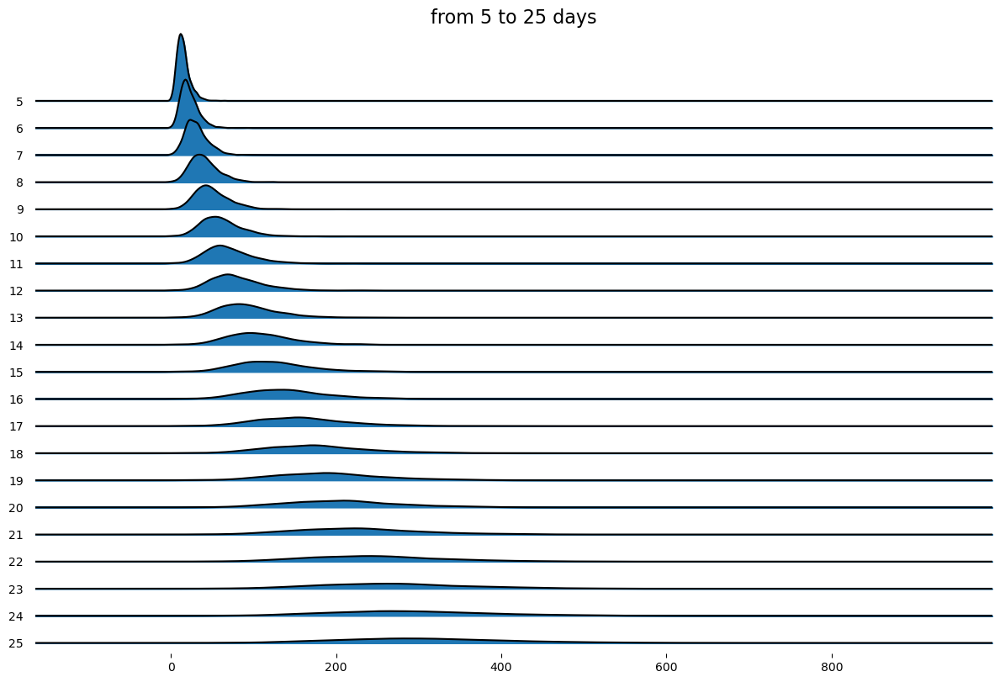

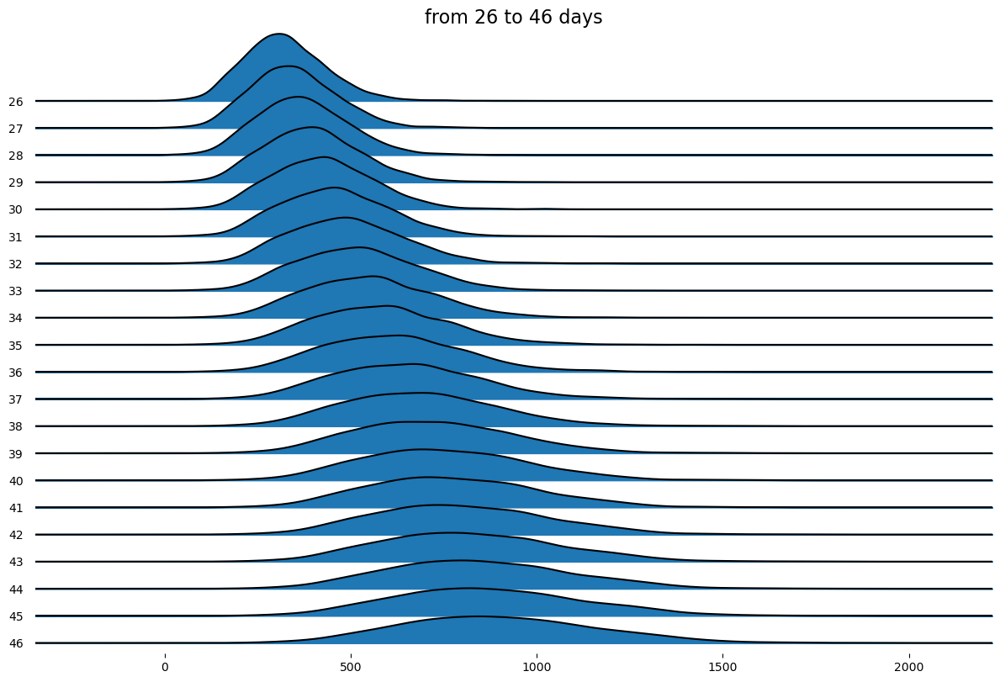

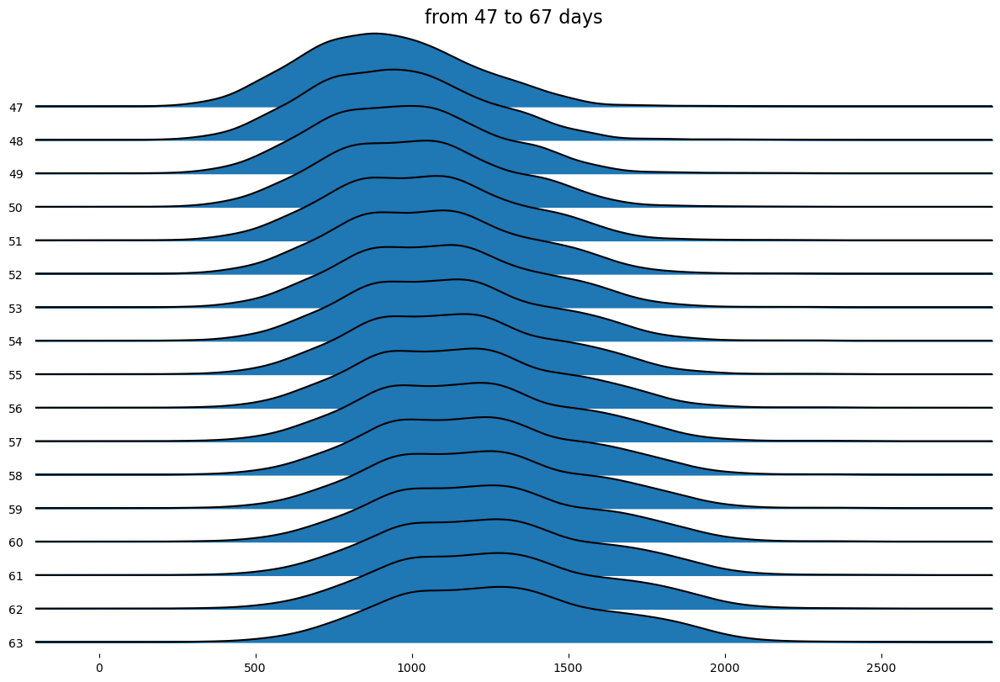

In [52]:
for i in range(5, 64, 21): 
    tt = temp_ds[(temp_ds.timewindow<i+21) & (temp_ds.timewindow>=i)]
    joyplot(
        data=tt[['counts', 'timewindow']], 
        by='timewindow',
        figsize=(12, 8)
    )
    plt.title(f'from {i} to {i+20} days', fontsize=16)
    plt.show()

    NOTE:
    
    > segment into 5 groups by the population portion

### [c1] viz of activity degree 


    refined definition based on the feedbacks -- based on the overall histroy, not for each given time windows. 

    > based on user's full history
    > based on user's activity per active day

#### [c1] activity by full history

In [12]:
def categories(row, t_list, col = 'activity_counts'):
    """t_list incl. [0, 33.33, 66.67, 100]"""
    if row[col]<=t_list[1]:
        return 1
    elif row[col]>t_list[1] and row[col]<=t_list[2]:
        return 2
    elif row[col]>t_list[2] and row[col]<=t_list[3]:
        return 3

In [17]:
# add the activity degree to the rec list results 
# READ IN EXPERIMENT RESULTS
# MODEL_LOC = f"{MODEL_LOC_ROOT}/{DATASET_NAME}/{MODEL}"

MODEL_LOC_ROOT = './Model/KuaiRec/'
MODEL_NAME = 'BPR'
DATASET_NAME = 'KuaiRec_1D'
DATASET_LOC = './Data/KuaiRec/'
DATASETS = {int(f.split('_')[-1]):f for f in os.listdir(DATASET_LOC) if f.startswith(DATASET_NAME)}
USER_COL = 'user_id'

calibration_comparison_1D_multi = {}
DATA_INDEX_max = max(DATASETS.keys())

# activity degree already available: activity_all_windows[DATA_INDEX+1]
temp_activity = activity_all_windows[DATA_INDEX_max+1]
percentiles_list = [np.percentile(temp_activity[['activity_counts']], _p) 
                    for _p in [0, 33.33, 66.67, 100]]
temp_activity['user_group_activity'] = temp_activity.apply(lambda row: categories(row, percentiles_list, 
                                                                                  'activity_counts'), 
                                                           axis=1)

# calculate entropy
DATASET = DATASETS[DATA_INDEX_max]
interact_dataset = pd.read_csv(f"{DATASET_LOC}/{DATASET}/{DATASET}.csv")
USER_IDS = interact_dataset[USER_COL].unique()
user_profile_entropy_dict = {_user:compute_profile_entropy(interact_dataset[interact_dataset[USER_COL]==_user][ITEM_COL].tolist(), 
                                                           item_cat_mapping) for _user in USER_IDS}
temp_entropy = pd.DataFrame.from_dict(user_profile_entropy_dict, orient='index', columns=['profile_entropy'])
temp_entropy.reset_index(names=[USER_COL],inplace=True)
percentiles_list = [np.percentile(temp_entropy[['profile_entropy']], _p) 
                    for _p in [0, 33.33, 66.67, 100]]
temp_entropy['user_group_entropy'] = temp_entropy.apply(lambda row: categories(row, percentiles_list, 
                                                                                'profile_entropy'), 
                                                        axis=1)
# all related side info 
temp = temp_activity.merge(temp_entropy, on=USER_COL)


for DATA_INDEX,DATASET in DATASETS.items():
    calibration_comparison_1D_multi[DATA_INDEX+1] = dict()
    interact_dataset = pd.read_csv(f"{DATASET_LOC}/{DATASET}/{DATASET}.csv")
    USER_IDS_STR = list(map(str, interact_dataset.user_id.unique())) #1409 users in total
    USER_IDS = interact_dataset[USER_COL].unique()
    #print(f"User amount from DatasetIndex {DATA_INDEX}: {len(USER_IDS)}")

    
    models = [_m for _m in os.listdir(f"{MODEL_LOC_ROOT}/{DATASET}") if _m.endswith('.pth') and _m.startswith(MODEL_NAME)]
    for model_file in models: 
        config, model, dataset, train_data, valid_data, test_data = load_data_and_model(
            model_file=f"{MODEL_LOC_ROOT}/{DATASET}/{model_file}",
        )
        uid_series = dataset.token2id(dataset.uid_field, USER_IDS_STR)
        topk_score, topk_iid_list = full_sort_topk_mod(
            uid_series, model, test_data, k=10, device=config["device"]
        )
        external_item_list = dataset.id2token(dataset.iid_field, topk_iid_list.cpu())
    
        ca_dict, ca_df = metric_calibration(interact_dataset, external_item_list, USER_IDS)
        ca_df['DataIndex'] = DATA_INDEX+1
        ca_df['ModelFile'] = model_file.split('.')[0]
        ca_df.reset_index(names=[USER_COL],inplace=True)
        ca_df.rename(columns={0:'miscalibration'},inplace=True)
        all_df = ca_df.merge(temp, on=USER_COL)
        calibration_comparison_1D_multi[DATA_INDEX+1][model_file.split('.')[0]] = all_df



25 Jan 17:19    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_39
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_39
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:19    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_39
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_39
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_39
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_39
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_39
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_39
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_39
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_39
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_39
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_39
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_30
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_30
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_30
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_30
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_30
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_30
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_30
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_30
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_30
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_30
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_30
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_30
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_37
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_37
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_37
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_37
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_37
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_37
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_37
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_37
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_37
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_37
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_37
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_37
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_52
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_52
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_52
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_52
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:21    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_52
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_52
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:21    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_52
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_52
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:21    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_52
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_52
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:21    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_52
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_52
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:21    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_55
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_55
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:21    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_55
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_55
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:21    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_55
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_55
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:21    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_55
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_55
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:21    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_55
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_55
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:21    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_55
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_55
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:21    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_36
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_36
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:21    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_36
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_36
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:22    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_36
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_36
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:22    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_36
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_36
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:22    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_36
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_36
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:22    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_36
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_36
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:22    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_31
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_31
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:22    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_31
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_31
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:22    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_31
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_31
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:22    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_31
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_31
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:22    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_31
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_31
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:22    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_31
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_31
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:22    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_38
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_38
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:22    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_38
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_38
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:22    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_38
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_38
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:22    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_38
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_38
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:22    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_38
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_38
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:22    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_38
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_38
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:22    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_54
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_54
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:22    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_54
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_54
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:23    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_54
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_54
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:23    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_54
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_54
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:23    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_54
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_54
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:23    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_54
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_54
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:23    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_53
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_53
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:23    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_53
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_53
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:23    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_53
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_53
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:23    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_53
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_53
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:23    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_53
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_53
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:23    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_53
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_53
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:24    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_62
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_62
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:24    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_62
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_62
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:24    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_62
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_62
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:24    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_62
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_62
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:24    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_62
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_62
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:24    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_62
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_62
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:24    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_40
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_40
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:24    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_40
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_40
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:24    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_40
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_40
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:24    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_40
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_40
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:24    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_40
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_40
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:24    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_40
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_40
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:25    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_47
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_47
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:25    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_47
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_47
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:25    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_47
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_47
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:25    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_47
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_47
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:25    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_47
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_47
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:25    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_47
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_47
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:25    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_49
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_49
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:25    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_49
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_49
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:25    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_49
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_49
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:25    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_49
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_49
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:25    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_49
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_49
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:25    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_49
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_49
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_22
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_22
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_22
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_22
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_22
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_22
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_22
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_22
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_22
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_22
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_22
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_22
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_25
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_25
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_25
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_25
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_25
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_25
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_25
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_25
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_25
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_25
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_25
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_25
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_13
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_13
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_13
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_13
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_13
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_13
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_13
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_13
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_13
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_13
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_13
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_13
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_14
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_14
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_14
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_14
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_14
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_14
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_14
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_14
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_14
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_14
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_14
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_14
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_48
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_48
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_48
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_48
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_48
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_48
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_48
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_48
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_48
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_48
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_48
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_48
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:27    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_46
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_46
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:27    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_46
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_46
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:27    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_46
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_46
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:27    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_46
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_46
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:27    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_46
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_46
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:27    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_46
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_46
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:27    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_41
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_41
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:27    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_41
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_41
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:27    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_41
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_41
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:27    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_41
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_41
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:27    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_41
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_41
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:27    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_41
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_41
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:27    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_15
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_15
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:27    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_15
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_15
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:27    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_15
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_15
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:27    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_15
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_15
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:27    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_15
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_15
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:27    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_15
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_15
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:27    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_12
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_12
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = Tr

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:27    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_12
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_12
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = Tr

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:27    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_12
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_12
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = Tr

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:27    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_12
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_12
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = Tr

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_12
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_12
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = Tr

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_12
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_12
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = Tr

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_24
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_24
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_24
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_24
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_24
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_24
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_24
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_24
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_23
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_23
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_23
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_23
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_23
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_23
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_23
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_23
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_23
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_23
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_23
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_23
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_7
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramet

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_7
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramet

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_7
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramet

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_7
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramet

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_7
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramet

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_7
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramet

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_0
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.01
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Parameter

Before mod: 491 and 491
After mod: 197 and 197
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_0
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.01
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Parameter

Before mod: 491 and 491
After mod: 197 and 197
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_0
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Parameters

Before mod: 491 and 491
After mod: 197 and 197
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_0
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.01
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Parameter

Before mod: 491 and 491
After mod: 197 and 197
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_0
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.01
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Parameter

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_9
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_9
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = Tru

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_9
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_9
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = Tru

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_9
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_9
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = Tru

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_9
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_9
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = Tru

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_9
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_9
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = Tru

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_8
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_8
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_8
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_8
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_8
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_8
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_1
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1086 and 1086
After mod: 694 and 694
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_1
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1086 and 1086
After mod: 694 and 694
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_1
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1086 and 1086
After mod: 694 and 694
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_1
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1086 and 1086
After mod: 694 and 694
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_1
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1086 and 1086
After mod: 694 and 694
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_1
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1086 and 1086
After mod: 694 and 694
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_6
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramet


users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_6
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramet

Before mod: 1409 and 1409
After mod: 1407 and 1407
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_6
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramet

Before mod: 1409 and 1409
After mod: 1407 and 1407
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_6
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramet

Before mod: 1409 and 1409
After mod: 1407 and 1407
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_6
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramet

Before mod: 1409 and 1409
After mod: 1407 and 1407
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_58
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_58
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_58
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_58
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_58
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_58
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_58
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_58
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:29    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_58
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_58
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:29    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_58
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_58
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:29    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_60
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_60
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:29    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_60
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_60
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:29    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_60
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_60
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:29    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_60
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_60
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:29    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_60
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_60
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:29    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_60
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_60
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:29    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_56
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_56
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:29    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_56
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_56
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:30    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_56
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_56
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:30    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_56
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_56
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:30    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_56
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_56
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:30    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_56
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_56
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:30    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_51
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_51
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:30    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_51
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_51
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:30    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_51
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_51
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:30    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_51
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_51
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:30    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_51
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_51
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:30    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_51
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_51
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:30    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_34
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_34
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:31    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_34
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_34
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:31    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_34
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_34
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:31    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_34
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_34
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:31    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_34
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_34
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:31    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_34
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_34
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:31    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_33
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_33
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:31    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_33
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_33
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:31    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_33
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_33
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:31    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_33
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_33
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:31    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_33
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_33
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:31    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_33
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_33
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:31    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_50
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_50
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:31    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_50
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_50
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:31    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_50
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_50
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:31    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_50
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_50
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:31    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_50
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_50
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:31    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_50
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_50
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:32    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_57
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_57
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:32    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_57
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_57
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:32    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_57
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_57
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:32    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_57
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_57
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:32    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_57
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_57
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:32    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_57
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_57
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:32    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_61
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_61
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:32    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_61
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_61
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:32    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_61
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_61
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:32    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_61
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_61
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:33    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_61
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_61
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:33    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_61
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_61
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:33    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_59
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_59
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:33    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_59
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_59
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:33    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_59
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_59
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:33    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_59
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_59
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:33    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_59
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_59
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:33    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_59
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_59
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:33    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_32
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_32
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:33    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_32
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_32
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:33    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_32
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_32
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_32
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_32
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_32
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_32
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_32
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_32
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_35
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_35
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_35
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_35
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_35
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_35
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_35
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_35
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_35
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_35
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_35
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_35
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_19
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_19
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_19
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_19
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_19
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_19
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_19
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_19
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_19
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_19
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_19
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_19
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_26
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_26
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_26
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_26
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_26
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_26
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_26
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_26
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_26
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_26
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_26
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_26
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_21
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_21
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = Tr

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_21
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_21
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = Tr

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_21
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_21
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = Tr

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_21
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_21
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = Tr

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_21
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_21
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = Tr

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_21
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_21
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = Tr

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_28
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_28
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_28
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_28
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_28
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_28
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_28
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_28
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_28
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_28
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_28
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_28
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_17
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_17
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_17
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_17
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_17
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_17
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_17
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_17
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_17
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_17
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_17
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_17
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_10
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_10
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


25 Jan 17:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_10
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_10
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


25 Jan 17:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_10
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_10
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


25 Jan 17:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_10
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_10
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


25 Jan 17:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_10
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_10
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


25 Jan 17:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_10
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_10
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


25 Jan 17:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_44
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_44
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_44
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_44
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_44
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_44
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_44
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_44
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_44
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_44
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_44
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_44
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_43
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_43
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_43
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_43
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_43
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_43
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_43
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_43
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_43
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_43
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_43
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_43
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_11
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_11
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1410 and 1410
users in inter and rec: consistent


25 Jan 17:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_11
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_11
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1410 and 1410
users in inter and rec: consistent


25 Jan 17:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_11
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_11
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1410 and 1410
users in inter and rec: consistent


25 Jan 17:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_11
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_11
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1410 and 1410
users in inter and rec: consistent


25 Jan 17:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_11
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_11
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1410 and 1410
users in inter and rec: consistent


25 Jan 17:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_11
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_11
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1410 and 1410
users in inter and rec: consistent


25 Jan 17:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_29
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_29
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_29
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_29
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_29
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_29
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_29
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_29
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_29
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_29
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_29
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_29
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_16
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_16
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_16
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_16
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_16
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_16
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_16
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_16
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_16
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_16
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_16
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_16
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_20
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_20
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_20
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_20
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_20
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_20
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_20
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_20
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_20
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_20
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_20
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_20
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_18
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_18
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_18
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_18
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:37    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_18
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_18
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:37    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_18
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_18
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:37    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_18
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_18
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:37    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_18
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_18
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:37    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_27
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_27
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:37    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_27
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_27
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:37    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_27
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_27
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:37    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_27
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_27
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:37    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_27
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_27
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:37    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_27
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_27
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:37    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_42
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_42
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:37    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_42
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_42
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:37    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_42
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_42
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:37    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_42
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_42
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:37    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_42
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_42
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:37    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_42
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_42
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:37    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_45
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_45
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:37    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_45
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_45
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:37    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_45
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_45
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:37    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_45
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_45
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:38    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_45
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_45
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:38    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_45
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_45
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


25 Jan 17:38    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_3
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.01
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Parameter

Before mod: 1394 and 1394
After mod: 1359 and 1359
users in inter and rec: consistent


25 Jan 17:38    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_3
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.01
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Parameter

Before mod: 1394 and 1394
After mod: 1359 and 1359
users in inter and rec: consistent


25 Jan 17:38    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_3
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.01
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Parameter

Before mod: 1394 and 1394
After mod: 1359 and 1359
users in inter and rec: consistent


25 Jan 17:38    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_3
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.01
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Parameter

Before mod: 1394 and 1394
After mod: 1359 and 1359
users in inter and rec: consistent


25 Jan 17:38    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_3
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.01
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Parameter

Before mod: 1394 and 1394
After mod: 1359 and 1359
users in inter and rec: consistent


25 Jan 17:38    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_3
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.01
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Parameter

Before mod: 1394 and 1394
After mod: 1359 and 1359
users in inter and rec: consistent


25 Jan 17:38    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_4
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.01
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Parameter

Before mod: 1407 and 1407
After mod: 1401 and 1401
users in inter and rec: consistent


25 Jan 17:38    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_4
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.01
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Parameter

Before mod: 1407 and 1407
After mod: 1401 and 1401
users in inter and rec: consistent


25 Jan 17:38    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_4
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.01
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Parameter

Before mod: 1407 and 1407
After mod: 1401 and 1401
users in inter and rec: consistent


25 Jan 17:38    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_4
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.01
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Parameter

Before mod: 1407 and 1407
After mod: 1401 and 1401
users in inter and rec: consistent


25 Jan 17:38    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_4
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.01
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Parameter

Before mod: 1407 and 1407
After mod: 1401 and 1401
users in inter and rec: consistent


25 Jan 17:38    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_4
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.01
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Parameter

Before mod: 1407 and 1407
After mod: 1401 and 1401
users in inter and rec: consistent


25 Jan 17:38    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_5
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1407 and 1407
After mod: 1405 and 1405
users in inter and rec: consistent


25 Jan 17:38    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_5
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1407 and 1407
After mod: 1405 and 1405
users in inter and rec: consistent


25 Jan 17:38    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_5
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1407 and 1407
After mod: 1405 and 1405
users in inter and rec: consistent


25 Jan 17:38    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_5
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1407 and 1407
After mod: 1405 and 1405
users in inter and rec: consistent


25 Jan 17:38    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_5
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1407 and 1407
After mod: 1405 and 1405
users in inter and rec: consistent


25 Jan 17:38    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_5
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1407 and 1407
After mod: 1405 and 1405
users in inter and rec: consistent


25 Jan 17:38    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_2
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1344 and 1344
After mod: 1229 and 1229
users in inter and rec: consistent


25 Jan 17:38    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_2
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1344 and 1344
After mod: 1229 and 1229
users in inter and rec: consistent


25 Jan 17:38    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_2
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1344 and 1344
After mod: 1229 and 1229
users in inter and rec: consistent


25 Jan 17:38    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_2
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1344 and 1344
After mod: 1229 and 1229
users in inter and rec: consistent


25 Jan 17:38    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_2
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1344 and 1344
After mod: 1229 and 1229
users in inter and rec: consistent


25 Jan 17:38    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_2
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1344 and 1344
After mod: 1229 and 1229
users in inter and rec: consistent


In [18]:
agg_inside_1d_df = {k:pd.concat(list(dfs.values())) for k, dfs in calibration_comparison_1D_multi.items()}
agg_across_1d_df = pd.concat(list(agg_inside_1d_df.values()))
agg_across_1d_df.sort_values(['DataIndex', 'ModelFile'], inplace=True)
agg_across_1d_df.head()

,user_id,calibration,DataIndex,ModelFile,activity_counts,user_group_activity,profile_entropy,user_group_entropy
0,19,5.549228,1,BPR-Dec-06-2023_19-39-13,1269,2,3.693648,1
1,24,4.579215,1,BPR-Dec-06-2023_19-39-13,954,1,3.743153,2
2,37,4.110428,1,BPR-Dec-06-2023_19-39-13,1424,3,3.806797,3
3,64,3.197600,1,BPR-Dec-06-2023_19-39-13,1886,3,3.862331,3
4,97,2.731472,1,BPR-Dec-06-2023_19-39-13,1384,2,3.751026,2


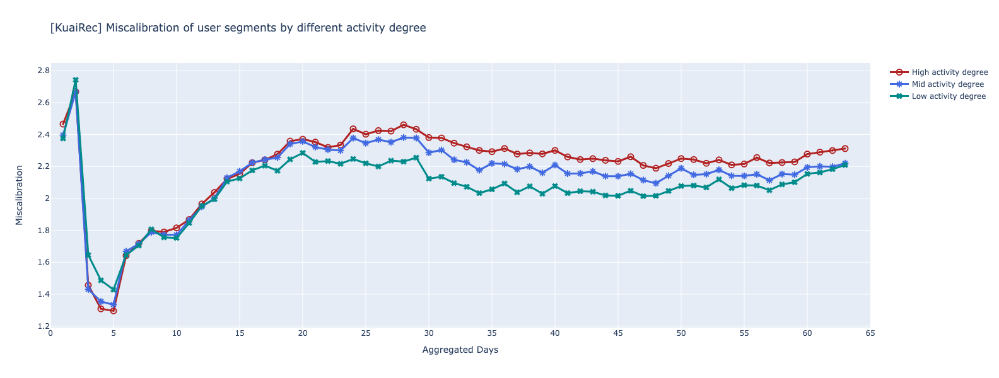

In [201]:
#lines = ['Low', 'Mid', 'High', 'All Population']
# segment users based on the count per user full history 
# viz 
DF = agg_across_1d_df
CAT_COL = 'DataIndex'
TARGET_COL = 'miscalibration'
DF_MEAN = DF[[CAT_COL,TARGET_COL]].groupby(CAT_COL, as_index=False).mean().melt(id_vars=CAT_COL)

GROUP_COL = 'user_group_activity'
DF_MEAN_GROUP = DF[[CAT_COL,TARGET_COL,GROUP_COL]].groupby([CAT_COL,GROUP_COL], as_index=False).mean().melt(id_vars=[CAT_COL,GROUP_COL])

lines_cat = 'activity degree'
lines = ['High', 'Mid', 'Low']
lines = [f"{_line} {lines_cat}" for _line in lines]
markers = ['circle-open-dot', 'asterisk-open', 'hash-open-dot']
colors = ['firebrick', 'royalblue', 'darkcyan']
dash = ['solid', 'dash', 'dot'] 

fig = go.Figure()
for i in range(3): 
    df_mean_group = DF_MEAN_GROUP[DF_MEAN_GROUP[GROUP_COL]==3-i]
    fig.add_trace(go.Scatter(
        x=df_mean_group['DataIndex'], # x-axis
        y=df_mean_group['value'], # y-axis
        mode='lines+markers', # Connect data points with lines and add markers
        name=lines[i], # Name in the legend

        marker=dict(
            symbol=markers[i],    # Change the marker symbol to a circle
            size=9,            # Set the marker size
            color=colors[i],
            line=dict(width=2)),       # Set the marker color

        line=dict(
            color=colors[i],        # Change the line color to red
            width=3)             # Set the line width
    ))

fig.update_layout(
    height=600, width=1300, 
    title='[KuaiRec] Miscalibration of user segments by different activity degree', # Title
    xaxis_title='Aggregated Days', # y-axis name
    yaxis_title='Miscalibration', # x-axis name
    #xaxis_tickangle=45,  # Set the x-axis label angle
    showlegend=True,     # Display the legend
    xaxis = dict(
        tickmode = 'linear',
        dtick =5,
        range=[0,65]
    )
)

### [c2] viz of user entropy 

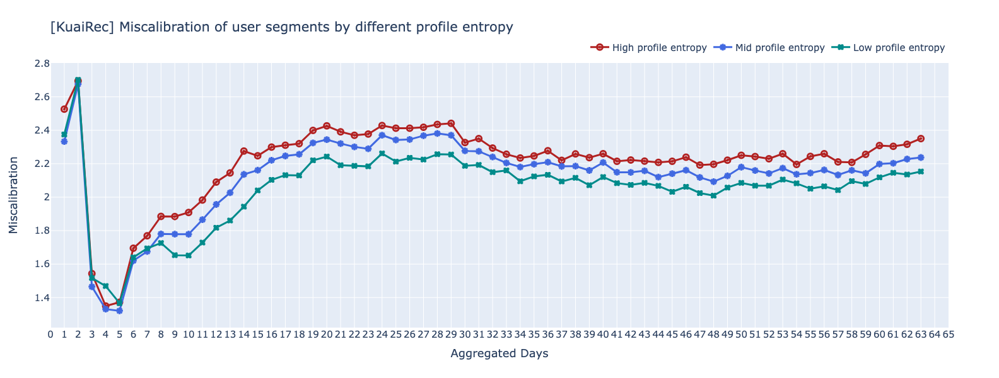

In [362]:
DF = agg_across_1d_df
CAT_COL = 'DataIndex'
TARGET_COL = 'miscalibration'
DF_MEAN = DF[[CAT_COL,TARGET_COL]].groupby(CAT_COL, as_index=False).mean().melt(id_vars=CAT_COL)

GROUP_COL = 'user_group_entropy'
DF_MEAN_GROUP = DF[[CAT_COL,TARGET_COL,GROUP_COL]].groupby([CAT_COL,GROUP_COL], as_index=False).mean().melt(id_vars=[CAT_COL,GROUP_COL])

lines_cat = 'profile entropy'
lines = ['High', 'Mid', 'Low']
lines = [f"{_line} {lines_cat}" for _line in lines]
markers = ['circle-open-dot', 'asterisk-open', 'hash-open-dot']
colors = ['firebrick', 'royalblue', 'darkcyan']
dash = ['solid', 'dash', 'dot'] 

fig = go.Figure()
for i in range(3): 
    df_mean_group = DF_MEAN_GROUP[DF_MEAN_GROUP[GROUP_COL]==3-i]
    fig.add_trace(go.Scatter(
        x=df_mean_group['DataIndex'], # x-axis
        y=df_mean_group['value'], # y-axis
        mode='lines+markers', # Connect data points with lines and add markers
        name=lines[i], # Name in the legend

        marker=dict(
            symbol=markers[i],    # Change the marker symbol to a circle
            size=9,            # Set the marker size
            color=colors[i],
            line=dict(width=line_size)),       # Set the marker color

        line=dict(
            color=colors[i],        # Change the line color to red
            width=line_size)             # Set the line width
    ))

fig.update_layout(
    height=600, width=1300, 
    title='[KuaiRec] Miscalibration of user segments by different profile entropy', # Title
    xaxis_title='Aggregated Days', # y-axis name
    yaxis_title='Miscalibration', # x-axis name
    #xaxis_tickangle=45,  # Set the x-axis label angle
    showlegend=True,     # Display the legend
    xaxis = dict(
        tickmode = 'linear',
        dtick =dtick_length,
        range=[0,65]
    ),
    legend=dict(
        orientation="h",
        yanchor="bottom",
        y=1.02,
        xanchor="right",
        x=1,
        font=dict(
            size=font_size,
        )),
    font=dict(size=font_size)
)
iplot(fig)
image_name = 'ProfileEntropy'
fig.write_image(f"{image_path}{image_name_pref}_{image_name}.png")

### [d] via different calibration group 
    
    whether for different calibration groups, the best time intervals pattern can be different. 

In [156]:
USER_COL = 'user_id'
CAT_COL = 'feat'
ITEM_COL = 'video_id'
DS_ALL_WINDOWS = ds_all_windows # key starts from 1
activity_entropy_all_windows = {}

for i, ds in DS_ALL_WINDOWS.items():
    # user activity
    temp_activity = ds.groupby(USER_COL).size().reset_index(name='activity_counts')
    percentiles_list = [np.percentile(temp_activity[['activity_counts']], _p) 
                        for _p in [0, 33.33, 66.67, 100]]
    temp_activity['user_group_activity'] = temp_activity.apply(lambda row: categories(row, percentiles_list, 
                                                                             'activity_counts'), axis=1)
    
    # profile entropy
    temp_user_ids = ds[USER_COL].unique()
    user_profile_entropy_dict = {_user:compute_profile_entropy(ds[ds[USER_COL]==_user][ITEM_COL].tolist(), 
                                                               item_cat_mapping) for _user in temp_user_ids}
    temp_entropy = pd.DataFrame.from_dict(user_profile_entropy_dict, orient='index', columns=['profile_entropy'])
    temp_entropy.reset_index(names=[USER_COL],inplace=True)
    percentiles_list = [np.percentile(temp_entropy[['profile_entropy']], _p) 
                        for _p in [0, 33.33, 66.67, 100]]
    temp_entropy['user_group_entropy'] = temp_entropy.apply(lambda row: categories(row, percentiles_list, 
                                                                                   'profile_entropy'), axis=1)
    
    # merge activity degree and profile together 
    activity_entropy_all_windows[i] = temp_activity.merge(temp_entropy, on=USER_COL)
    
    

In [169]:
# create the calibration results
MODEL_LOC_ROOT = './Model/KuaiRec/'
MODEL_NAME = 'BPR'
DATASET_NAME = 'KuaiRec_1D'
DATASET_LOC = './Data/KuaiRec/'
DATASETS = {int(f.split('_')[-1]):f for f in os.listdir(DATASET_LOC) if f.startswith(DATASET_NAME)}
USER_COL = 'user_id'

calibration_comparison_1D_multi = {}

# activity degree already available: activity_all_windows[DATA_INDEX+1]
temp = activity_entropy_all_windows[DATA_INDEX_max]

for DATA_INDEX,DATASET in DATASETS.items():
    calibration_comparison_1D_multi[DATA_INDEX+1] = dict()
    interact_dataset = pd.read_csv(f"{DATASET_LOC}/{DATASET}/{DATASET}.csv")
    USER_IDS_STR = list(map(str, interact_dataset.user_id.unique())) 
    USER_IDS = interact_dataset[USER_COL].unique()
    
    models = [_m for _m in os.listdir(f"{MODEL_LOC_ROOT}/{DATASET}") if _m.endswith('.pth') and _m.startswith(MODEL_NAME)]
    for model_file in models: 
        config, model, dataset, train_data, valid_data, test_data = load_data_and_model(
            model_file=f"{MODEL_LOC_ROOT}/{DATASET}/{model_file}",
        )
        uid_series = dataset.token2id(dataset.uid_field, USER_IDS_STR)
        topk_score, topk_iid_list = full_sort_topk_mod(
            uid_series, model, test_data, k=10, device=config["device"]
        )
        external_item_list = dataset.id2token(dataset.iid_field, topk_iid_list.cpu())
    
        ca_dict, ca_df = metric_calibration(interact_dataset, external_item_list, USER_IDS)
        ca_df['DataIndex'] = DATA_INDEX+1
        ca_df['ModelFile'] = model_file.split('.')[0]
        ca_df.reset_index(names=[USER_COL],inplace=True)
        ca_df.rename(columns={0:'miscalibration'},inplace=True)
        # group the calibration groups -- low, mid, high
        percentiles_list = [np.percentile(ca_df[['miscalibration']], _p) 
                            for _p in [0, 33.33, 66.67, 100]]
        ca_df['user_group_miscalibration_current'] = ca_df.apply(lambda row: categories(row, percentiles_list, 
                                                                                        'miscalibration'), axis=1)
        all_df = ca_df.merge(temp, on=USER_COL)
        calibration_comparison_1D_multi[DATA_INDEX+1][model_file.split('.')[0]] = all_df



27 Jan 14:05    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_39
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_39
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:05    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_39
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_39
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:05    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_39
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_39
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:05    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_39
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_39
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:05    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_39
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_39
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:05    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_39
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_39
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:05    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_30
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_30
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:06    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_30
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_30
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:06    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_30
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_30
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:06    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_30
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_30
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:06    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_30
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_30
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:06    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_30
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_30
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:06    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_37
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_37
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:06    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_37
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_37
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:06    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_37
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_37
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:06    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_37
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_37
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:06    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_37
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_37
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:06    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_37
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_37
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:06    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_52
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_52
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:07    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_52
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_52
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:07    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_52
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_52
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:07    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_52
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_52
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:07    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_52
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_52
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:07    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_52
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_52
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:07    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_55
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_55
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:07    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_55
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_55
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:07    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_55
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_55
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:08    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_55
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_55
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:08    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_55
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_55
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:08    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_55
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_55
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:08    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_36
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_36
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:08    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_36
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_36
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:08    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_36
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_36
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:08    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_36
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_36
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:08    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_36
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_36
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:08    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_36
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_36
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:08    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_31
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_31
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:09    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_31
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_31
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:09    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_31
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_31
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:09    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_31
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_31
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:09    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_31
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_31
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:09    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_31
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_31
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:09    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_38
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_38
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:09    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_38
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_38
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:09    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_38
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_38
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:09    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_38
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_38
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:09    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_38
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_38
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:09    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_38
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_38
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:10    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_54
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_54
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:10    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_54
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_54
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:10    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_54
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_54
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:10    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_54
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_54
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:10    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_54
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_54
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:10    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_54
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_54
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:10    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_53
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_53
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:10    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_53
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_53
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:11    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_53
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_53
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:11    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_53
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_53
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:11    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_53
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_53
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:11    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_53
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_53
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:11    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_62
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_62
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:11    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_62
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_62
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:11    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_62
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_62
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:11    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_62
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_62
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:12    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_62
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_62
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:12    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_62
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_62
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:12    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_40
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_40
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:12    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_40
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_40
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:12    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_40
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_40
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:12    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_40
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_40
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:12    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_40
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_40
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:12    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_40
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_40
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:12    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_47
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_47
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:13    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_47
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_47
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:13    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_47
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_47
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:13    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_47
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_47
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:13    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_47
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_47
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:13    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_47
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_47
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:13    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_49
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_49
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:13    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_49
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_49
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:13    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_49
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_49
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:14    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_49
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_49
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:14    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_49
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_49
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:14    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_49
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_49
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:14    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_22
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_22
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:14    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_22
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_22
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:14    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_22
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_22
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:14    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_22
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_22
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:14    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_22
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_22
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:14    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_22
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_22
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:14    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_25
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_25
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:14    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_25
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_25
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:14    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_25
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_25
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:15    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_25
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_25
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:15    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_25
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_25
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:15    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_25
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_25
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:15    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_13
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_13
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:15    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_13
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_13
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:15    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_13
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_13
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:15    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_13
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_13
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:15    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_13
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_13
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:15    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_13
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_13
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:15    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_14
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_14
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:15    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_14
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_14
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:15    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_14
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_14
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:15    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_14
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_14
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:15    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_14
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_14
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:15    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_14
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_14
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:15    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_48
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_48
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:15    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_48
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_48
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:16    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_48
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_48
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:16    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_48
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_48
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:16    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_48
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_48
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:16    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_48
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_48
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:16    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_46
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_46
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:16    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_46
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_46
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:16    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_46
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_46
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:16    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_46
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_46
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:17    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_46
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_46
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:17    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_46
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_46
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:17    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_41
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_41
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:17    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_41
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_41
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:17    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_41
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_41
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:17    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_41
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_41
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:17    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_41
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_41
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:17    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_41
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_41
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:17    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_15
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_15
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:17    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_15
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_15
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:18    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_15
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_15
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:18    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_15
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_15
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:18    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_15
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_15
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:18    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_15
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_15
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:18    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_12
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_12
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = Tr

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:18    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_12
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_12
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = Tr

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:18    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_12
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_12
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = Tr

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:18    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_12
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_12
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = Tr

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:18    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_12
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_12
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = Tr

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:18    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_12
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_12
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = Tr

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:18    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_24
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_24
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:18    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_24
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_24
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:18    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_24
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_24
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:18    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_24
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_24
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:18    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_24
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_24
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:18    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_24
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_24
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:18    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_23
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_23
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:19    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_23
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_23
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:19    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_23
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_23
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:19    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_23
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_23
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:19    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_23
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_23
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:19    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_23
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_23
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:19    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_7
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramet

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


27 Jan 14:19    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_7
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramet

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


27 Jan 14:19    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_7
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramet

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


27 Jan 14:19    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_7
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramet

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


27 Jan 14:19    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_7
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramet

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


27 Jan 14:19    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_7
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramet

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


27 Jan 14:19    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_0
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.01
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Parameter

Before mod: 491 and 491
After mod: 197 and 197
users in inter and rec: consistent


27 Jan 14:19    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_0
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.01
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Parameter

Before mod: 491 and 491
After mod: 197 and 197
users in inter and rec: consistent


27 Jan 14:19    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_0
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Parameters

Before mod: 491 and 491
After mod: 197 and 197
users in inter and rec: consistent


27 Jan 14:19    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_0
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.01
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Parameter

Before mod: 491 and 491
After mod: 197 and 197
users in inter and rec: consistent


27 Jan 14:19    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_0
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.01
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Parameter

Before mod: 491 and 491
After mod: 197 and 197
users in inter and rec: consistent


27 Jan 14:19    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_0
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.01
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Parameter

Before mod: 491 and 491
After mod: 197 and 197
users in inter and rec: consistent


27 Jan 14:19    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_9
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_9
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = Tru

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


27 Jan 14:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_9
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_9
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = Tru

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


27 Jan 14:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_9
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_9
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = Tru

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


27 Jan 14:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_9
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_9
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = Tru

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


27 Jan 14:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_9
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_9
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = Tru

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


27 Jan 14:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_9
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_9
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = Tru

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


27 Jan 14:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_8
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


27 Jan 14:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_8
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


27 Jan 14:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_8
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


27 Jan 14:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_8
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


27 Jan 14:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_8
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


27 Jan 14:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_8
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


27 Jan 14:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_1
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1086 and 1086
After mod: 694 and 694
users in inter and rec: consistent


27 Jan 14:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_1
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1086 and 1086
After mod: 694 and 694
users in inter and rec: consistent


27 Jan 14:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_1
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1086 and 1086
After mod: 694 and 694
users in inter and rec: consistent


27 Jan 14:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_1
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1086 and 1086
After mod: 694 and 694
users in inter and rec: consistent


27 Jan 14:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_1
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1086 and 1086
After mod: 694 and 694
users in inter and rec: consistent


27 Jan 14:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_1
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1086 and 1086
After mod: 694 and 694
users in inter and rec: consistent


27 Jan 14:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_6
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramet

Before mod: 1409 and 1409
After mod: 1407 and 1407
users in inter and rec: consistent


27 Jan 14:20    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_6
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramet

Before mod: 1409 and 1409
After mod: 1407 and 1407
users in inter and rec: consistent


27 Jan 14:21    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_6
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramet

Before mod: 1409 and 1409
After mod: 1407 and 1407
users in inter and rec: consistent


27 Jan 14:21    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_6
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramet

Before mod: 1409 and 1409
After mod: 1407 and 1407
users in inter and rec: consistent


27 Jan 14:21    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_6
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramet

Before mod: 1409 and 1409
After mod: 1407 and 1407
users in inter and rec: consistent


27 Jan 14:21    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_6
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramet

Before mod: 1409 and 1409
After mod: 1407 and 1407
users in inter and rec: consistent


27 Jan 14:21    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_58
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_58
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:21    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_58
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_58
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:21    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_58
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_58
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:21    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_58
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_58
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:21    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_58
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_58
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:21    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_58
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_58
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:22    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_60
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_60
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:22    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_60
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_60
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:22    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_60
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_60
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:22    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_60
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_60
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:22    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_60
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_60
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:22    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_60
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_60
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:22    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_56
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_56
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:23    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_56
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_56
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:23    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_56
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_56
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:23    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_56
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_56
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:23    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_56
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_56
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:23    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_56
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_56
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:23    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_51
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_51
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:23    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_51
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_51
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:24    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_51
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_51
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:24    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_51
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_51
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:24    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_51
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_51
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:24    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_51
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_51
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:24    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_34
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_34
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:24    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_34
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_34
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:24    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_34
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_34
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:24    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_34
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_34
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:25    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_34
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_34
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:25    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_34
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_34
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:25    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_33
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_33
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:25    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_33
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_33
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:25    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_33
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_33
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:25    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_33
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_33
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:25    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_33
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_33
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:25    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_33
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_33
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:25    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_50
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_50
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:25    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_50
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_50
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_50
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_50
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_50
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_50
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_50
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_50
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_50
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_50
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_57
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_57
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_57
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_57
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:26    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_57
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_57
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:27    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_57
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_57
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:27    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_57
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_57
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:27    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_57
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_57
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:27    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_61
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_61
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:27    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_61
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_61
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:27    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_61
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_61
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:27    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_61
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_61
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_61
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_61
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_61
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_61
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_59
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_59
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_59
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_59
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_59
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_59
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:28    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_59
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_59
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:29    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_59
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_59
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:29    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_59
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_59
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:29    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_32
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_32
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:29    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_32
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_32
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:29    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_32
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_32
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:29    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_32
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_32
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:29    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_32
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_32
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:29    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_32
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_32
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:29    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_35
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_35
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:29    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_35
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_35
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:30    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_35
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_35
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:30    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_35
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_35
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:30    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_35
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_35
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:30    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_35
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_35
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:30    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_19
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_19
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:30    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_19
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_19
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:30    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_19
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_19
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:30    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_19
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_19
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:30    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_19
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_19
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:30    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_19
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_19
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:30    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_26
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_26
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:30    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_26
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_26
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:31    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_26
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_26
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:31    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_26
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_26
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:31    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_26
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_26
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:31    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_26
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_26
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:31    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_21
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_21
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = Tr

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:31    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_21
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_21
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = Tr

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:31    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_21
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_21
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = Tr

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:31    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_21
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_21
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = Tr

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:31    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_21
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_21
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = Tr

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:31    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_21
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_21
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = Tr

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:31    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_28
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_28
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:31    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_28
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_28
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:32    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_28
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_28
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:32    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_28
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_28
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:32    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_28
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_28
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:32    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_28
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_28
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:32    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_17
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_17
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:32    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_17
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_17
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:32    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_17
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_17
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:32    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_17
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_17
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:32    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_17
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_17
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:32    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_17
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_17
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:32    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_10
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_10
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


27 Jan 14:32    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_10
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_10
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


27 Jan 14:32    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_10
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_10
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


27 Jan 14:33    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_10
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_10
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


27 Jan 14:33    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_10
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_10
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


27 Jan 14:33    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_10
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_10
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1410 and 1410
After mod: 1409 and 1409
users in inter and rec: consistent


27 Jan 14:33    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_44
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_44
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:33    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_44
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_44
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:33    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_44
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_44
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:33    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_44
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_44
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:33    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_44
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_44
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:33    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_44
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_44
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:33    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_43
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_43
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_43
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_43
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_43
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_43
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_43
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_43
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_43
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_43
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_43
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_43
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_11
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_11
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1410 and 1410
users in inter and rec: consistent


27 Jan 14:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_11
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_11
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1410 and 1410
users in inter and rec: consistent


27 Jan 14:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_11
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_11
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1410 and 1410
users in inter and rec: consistent


27 Jan 14:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_11
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_11
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1410 and 1410
users in inter and rec: consistent


27 Jan 14:34    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_11
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_11
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1410 and 1410
users in inter and rec: consistent


27 Jan 14:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_11
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_11
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1410 and 1410
users in inter and rec: consistent


27 Jan 14:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_29
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_29
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_29
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_29
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_29
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_29
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_29
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_29
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_29
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_29
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_29
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_29
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_16
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_16
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_16
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_16
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_16
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_16
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_16
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_16
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:35    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_16
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_16
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_16
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_16
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_20
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_20
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_20
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_20
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_20
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_20
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_20
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_20
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_20
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_20
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_20
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_20
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_18
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_18
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_18
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_18
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_18
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_18
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_18
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_18
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_18
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_18
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_18
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_18
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:36    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_27
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_27
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:37    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_27
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_27
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:37    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_27
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_27
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:37    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_27
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_27
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:37    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_27
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_27
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:37    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_27
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_27
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:37    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_42
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_42
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:37    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_42
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_42
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:37    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_42
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_42
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:37    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_42
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_42
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:38    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_42
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_42
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:38    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_42
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_42
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:38    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_45
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_45
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:38    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_45
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_45
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:38    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_45
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_45
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:38    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_45
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_45
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:38    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_45
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_45
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:38    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_45
checkpoint_dir = /Users/linkun/Documents/R-F/Experiments/Code/Calibration/KuaiRec/KuaiRec_1D_45
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.0001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = T

Before mod: 1411 and 1411
After mod: 1411 and 1411
users in inter and rec: consistent


27 Jan 14:39    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_3
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.01
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Parameter

Before mod: 1394 and 1394
After mod: 1359 and 1359
users in inter and rec: consistent


27 Jan 14:39    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_3
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.01
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Parameter

Before mod: 1394 and 1394
After mod: 1359 and 1359
users in inter and rec: consistent


27 Jan 14:39    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_3
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.01
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Parameter

Before mod: 1394 and 1394
After mod: 1359 and 1359
users in inter and rec: consistent


27 Jan 14:39    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_3
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.01
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Parameter

Before mod: 1394 and 1394
After mod: 1359 and 1359
users in inter and rec: consistent


27 Jan 14:39    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_3
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.01
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Parameter

Before mod: 1394 and 1394
After mod: 1359 and 1359
users in inter and rec: consistent


27 Jan 14:39    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_3
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.01
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Parameter

Before mod: 1394 and 1394
After mod: 1359 and 1359
users in inter and rec: consistent


27 Jan 14:39    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_4
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.01
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Parameter

Before mod: 1407 and 1407
After mod: 1401 and 1401
users in inter and rec: consistent


27 Jan 14:39    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_4
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.01
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Parameter

Before mod: 1407 and 1407
After mod: 1401 and 1401
users in inter and rec: consistent


27 Jan 14:39    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_4
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.01
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Parameter

Before mod: 1407 and 1407
After mod: 1401 and 1401
users in inter and rec: consistent


27 Jan 14:39    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_4
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.01
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Parameter

Before mod: 1407 and 1407
After mod: 1401 and 1401
users in inter and rec: consistent


27 Jan 14:39    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_4
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.01
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Parameter

Before mod: 1407 and 1407
After mod: 1401 and 1401
users in inter and rec: consistent


27 Jan 14:39    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_4
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.01
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Parameter

Before mod: 1407 and 1407
After mod: 1401 and 1401
users in inter and rec: consistent


27 Jan 14:39    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_5
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1407 and 1407
After mod: 1405 and 1405
users in inter and rec: consistent


27 Jan 14:40    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_5
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1407 and 1407
After mod: 1405 and 1405
users in inter and rec: consistent


27 Jan 14:40    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_5
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1407 and 1407
After mod: 1405 and 1405
users in inter and rec: consistent


27 Jan 14:40    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_5
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1407 and 1407
After mod: 1405 and 1405
users in inter and rec: consistent


27 Jan 14:40    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_5
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1407 and 1407
After mod: 1405 and 1405
users in inter and rec: consistent


27 Jan 14:40    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_5
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1407 and 1407
After mod: 1405 and 1405
users in inter and rec: consistent


27 Jan 14:40    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2021
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_2
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1344 and 1344
After mod: 1229 and 1229
users in inter and rec: consistent


27 Jan 14:40    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2022
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_2
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1344 and 1344
After mod: 1229 and 1229
users in inter and rec: consistent


27 Jan 14:40    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2024
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_2
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1344 and 1344
After mod: 1229 and 1229
users in inter and rec: consistent


27 Jan 14:40    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2025
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_2
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1344 and 1344
After mod: 1229 and 1229
users in inter and rec: consistent


27 Jan 14:40    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2023
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_2
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1344 and 1344
After mod: 1229 and 1229
users in inter and rec: consistent


27 Jan 14:40    INFO  
General Hyper Parameters:
gpu_id = 0
use_gpu = True
seed = 2020
state = INFO
reproducibility = True
data_path = dataset/KuaiRec_1D_2
checkpoint_dir = saved
show_progress = True
save_dataset = False
dataset_save_path = None
save_dataloaders = False
dataloaders_save_path = None
log_wandb = False

Training Hyper Parameters:
epochs = 300
train_batch_size = 2048
learner = adam
learning_rate = 0.001
train_neg_sample_args = {'distribution': 'uniform', 'sample_num': 1, 'alpha': 1.0, 'dynamic': False, 'candidate_num': 0}
eval_step = 1
stopping_step = 10
clip_grad_norm = None
weight_decay = 0.0
loss_decimal_place = 4

Evaluation Hyper Parameters:
eval_args = {'split': {'RS': [0.8, 0.1, 0.1]}, 'order': 'RO', 'group_by': 'user', 'mode': {'valid': 'full', 'test': 'full'}}
repeatable = False
metrics = ['Recall', 'MRR', 'NDCG', 'Hit', 'Precision']
topk = [10]
valid_metric = MRR@10
valid_metric_bigger = True
eval_batch_size = 4096
metric_decimal_place = 4

Dataset Hyper Paramete

Before mod: 1344 and 1344
After mod: 1229 and 1229
users in inter and rec: consistent


In [171]:
import pickle
with open('kuairec_calibration_comparison_1D_multi.pickle', 'wb') as handle:
    pickle.dump(calibration_comparison_1D_multi, handle, protocol=pickle.HIGHEST_PROTOCOL)

#with open('kuairec_calibration_comparison_1D_multi.pickle', 'rb') as handle:
#    calibration_comparison_1D_multi = pickle.load(handle)

In [172]:
# add on "user_group_miscalibration" to the df, based on the recommendation modeled by full history. 
# "user_group_X" means the user segments based on "X" of the full data (independently from time windows they are in) 
# get the majority vote for based on the 6 models 

temp_calibration_group_dict = calibration_comparison_1D_multi[max(calibration_comparison_1D_multi.keys())].copy()

ids_calibration_dict = {}
for i, df in temp_calibration_group_dict.items():
    ids_calibration_dict[i] = dict(zip(df[USER_COL], df['user_group_miscalibration_current']))
    
super_ids_calibration_dict = collections.defaultdict(list)
for d in ids_calibration_dict.values():
    for k, v in d.items(): 
        super_ids_calibration_dict[k].append(v)
        
# get majority vote
temp_calibration_group_dict_maj = {_id:Counter(_list).most_common(1)[0][0]
                                   for _id, _list in super_ids_calibration_dict.items()}
temp_calibration_group = pd.DataFrame.from_dict(temp_calibration_group_dict_maj, orient='index', columns=['user_group_miscalibration'])
temp_calibration_group.reset_index(names=[USER_COL],inplace=True)

In [173]:
agg_inside_1d_df = {k:pd.concat(list(dfs.values())) for k, dfs in calibration_comparison_1D_multi.items()}
agg_across_1d_df = pd.concat(list(agg_inside_1d_df.values()))
agg_across_1d_df.sort_values(['DataIndex', 'ModelFile'], inplace=True)
agg_across_1d_df = agg_across_1d_df.merge(temp_calibration_group, on=USER_COL)
agg_across_1d_df.head()

,user_id,miscalibration,DataIndex,ModelFile,user_group_miscalibration_current,activity_counts,user_group_activity,profile_entropy,user_group_entropy,user_group_miscalibration
0,19,5.549228,1,BPR-Dec-06-2023_19-39-13,3,1269,2,3.693648,1,2
1,19,3.259764,1,BPR-Dec-06-2023_19-39-16,3,1269,2,3.693648,1,2
2,19,3.828885,1,BPR-Dec-06-2023_19-39-20,3,1269,2,3.693648,1,2
3,19,1.541672,1,BPR-Dec-06-2023_19-39-23,1,1269,2,3.693648,1,2
4,19,5.164737,1,BPR-Dec-06-2023_19-39-27,3,1269,2,3.693648,1,2


#### [d1] non-segmented via different calibration group 

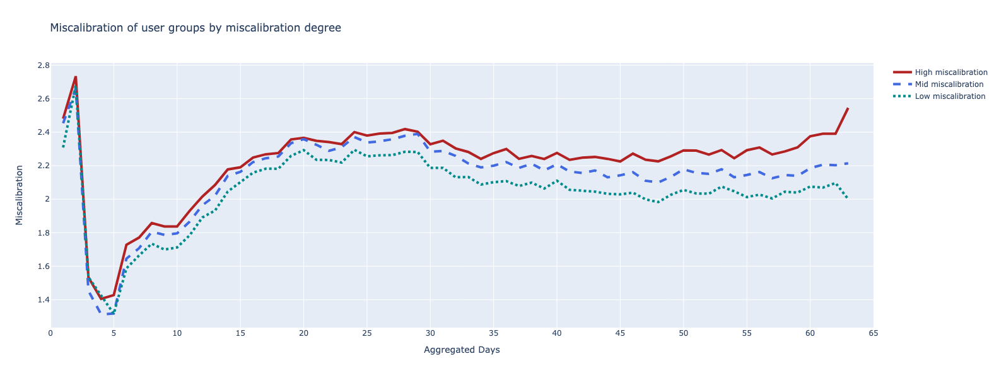

In [192]:

DF = agg_across_1d_df
CAT_COL = 'DataIndex'
TARGET_COL = 'miscalibration'
DF_MEAN = DF[[CAT_COL,TARGET_COL]].groupby(CAT_COL, as_index=False).mean().melt(id_vars=CAT_COL)

GROUP_COL = 'user_group_miscalibration'
DF_MEAN_GROUP = DF[[CAT_COL,TARGET_COL,GROUP_COL]].groupby([CAT_COL,GROUP_COL], as_index=False).mean().melt(id_vars=[CAT_COL,GROUP_COL])

lines = ['High miscalibration', 'Mid miscalibration', 'Low miscalibration']
markers = ['circle-open-dot', 'asterisk-open', 'square-open-dot']
colors = ['firebrick', 'royalblue', 'darkcyan', 'red']
dashes = ['solid', 'dash', 'dot'] 

fig = go.Figure()
for i in range(3): 
    #df_mean_group = DF_MEAN_GROUP[DF_MEAN_GROUP[GROUP_COL]==i+1]
    df_mean_group = DF_MEAN_GROUP[DF_MEAN_GROUP[GROUP_COL]==3-i]
    fig.add_trace(go.Scatter(
        x=df_mean_group['DataIndex'], # x-axis
        y=df_mean_group['value'], # y-axis
        mode='lines', # Connect data points with lines and add markers
        name=lines[i], # Name in the legend

        #marker=dict(
        #    symbol=markers[i],    # Change the marker symbol to a circle
        #    size=9,            # Set the marker size
        #    color=colors[i],
        #    line=dict(width=2)),       # Set the marker color

        line=dict(
            color=colors[i],        # Change the line color to red
            width=4,
            dash=dashes[i])             # Set the line width
    ))

fig.update_layout(
    height=600, width=1300, 
    #title=f'Miscalibration of user segments by different {GROUP_COL}', # Title
    title=f'Miscalibration of user groups by miscalibration degree', # Title
    xaxis_title='Aggregated Days', # y-axis name
    yaxis_title='Miscalibration', # x-axis name
    #xaxis_tickangle=45,  # Set the x-axis label angle
    showlegend=True,     # Display the legend
    xaxis = dict(
        tickmode = 'linear',
        dtick =5,
        range=[0,65]
    )
)

#### [d2] segmented via different calibration group 

In [186]:
CAT_COL = 'DataIndex'
GROUP_COL = 'user_group_miscalibration'
SEGMENT_COL = 'user_group_activity'


DF_MEAN_GROUP = DF[[CAT_COL,TARGET_COL,GROUP_COL,SEGMENT_COL]].groupby([CAT_COL,GROUP_COL, SEGMENT_COL], 
                                                                       as_index=False).mean().melt(id_vars=[CAT_COL,GROUP_COL,SEGMENT_COL])
DF_MEAN_GROUP.head()

,DataIndex,user_group_miscalibration,user_group_activity,variable,value
0,1,1,1,miscalibration,2.282242
1,1,1,2,miscalibration,2.343565
2,1,1,3,miscalibration,2.300973
3,1,2,1,miscalibration,2.419744
4,1,2,2,miscalibration,2.387492


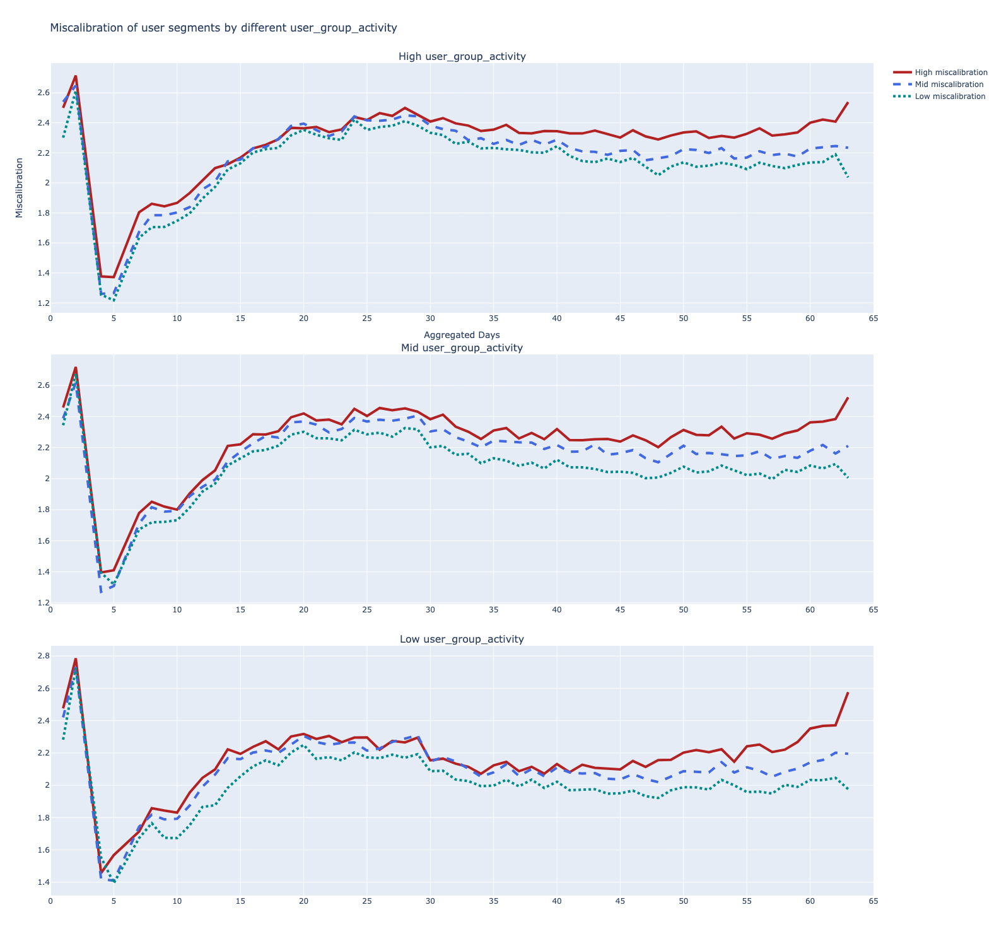

In [154]:
# change from one viz to subplotly. 
# subplot by differenet segments
colors = ['firebrick', 'royalblue', 'darkcyan']
dash = ['solid', 'dash', 'dot'] 
markers = ['circle-open-dot', 'asterisk-open', 'hash-open-dot']
lines_cat = 'miscalibration' # GROUP NAME
lines = [f"{_line} {lines_cat}" for _line in ['High', 'Mid', 'Low']]
legends = [True, False, False]

fig = make_subplots(
    rows = 3, cols=1,
    subplot_titles=[f"{i} {SEGMENT_COL}" for i in ['High','Mid','Low']],
    vertical_spacing= 0.05
)

for plot_row, seg_index in zip(range(1,4), reversed(range(1, 4))): # user segment in this subplots
    df_mean_groups = DF_MEAN_GROUP[DF_MEAN_GROUP[SEGMENT_COL]==seg_index]
    for line_index, group_index in zip(range(3),reversed(range(1, 4))):#order from high to low group value
        df_mean_group = df_mean_groups[df_mean_groups[GROUP_COL]==group_index]
        fig.add_trace(go.Scatter(
            x=df_mean_group['DataIndex'], # x-axis
            y=df_mean_group['value'], # y-axis
            #mode='lines+markers', # Connect data points with lines and add markers
            mode='lines',
            name=f"{lines[line_index]}", # Name in the legend

            #marker=dict(
            #    symbol=markers[i],    # Change the marker symbol to a circle
            #    size=8,            # Set the marker size
            #    color=colors[i]),       # Set the marker color

            line=dict(
                color=colors[line_index],        # Change the line color to red
                width=4, 
                dash=dash[line_index]),             # Set the line width
            showlegend = legends[plot_row-1],
        ), row=plot_row, col=1, )
        

fig.update_layout(
    height=1500, width=1300, 
    title=f'Miscalibration of user segments by different {SEGMENT_COL}', # Title
    xaxis_title='Aggregated Days', # y-axis name
    yaxis_title='Miscalibration', # x-axis name
    #xaxis_tickangle=45,  # Set the x-axis label angle
    showlegend=True,     # Display the legend
    xaxis = dict(
        tickmode = 'linear',
        dtick =5,
        range=[0,65]
        
    ),
    xaxis2 = dict(
        tickmode = 'linear',
        dtick =5,
        range=[0,65]
    ),
    xaxis3 = dict(
        tickmode = 'linear',
        dtick =5,
        range=[0,65]
    )
)    

In [196]:
CAT_COL = 'DataIndex'
GROUP_COL = 'user_group_miscalibration'
SEGMENT_COL = 'user_group_entropy'


DF_MEAN_GROUP = DF[[CAT_COL,TARGET_COL,GROUP_COL,SEGMENT_COL]].groupby([CAT_COL,GROUP_COL, SEGMENT_COL], 
                                                                       as_index=False).mean().melt(id_vars=[CAT_COL,GROUP_COL,SEGMENT_COL])
DF_MEAN_GROUP.head()

,DataIndex,user_group_miscalibration,user_group_entropy,variable,value
0,1,1,1,miscalibration,2.345875
1,1,1,2,miscalibration,2.220048
2,1,1,3,miscalibration,2.382879
3,1,2,1,miscalibration,2.424386
4,1,2,2,miscalibration,2.410237


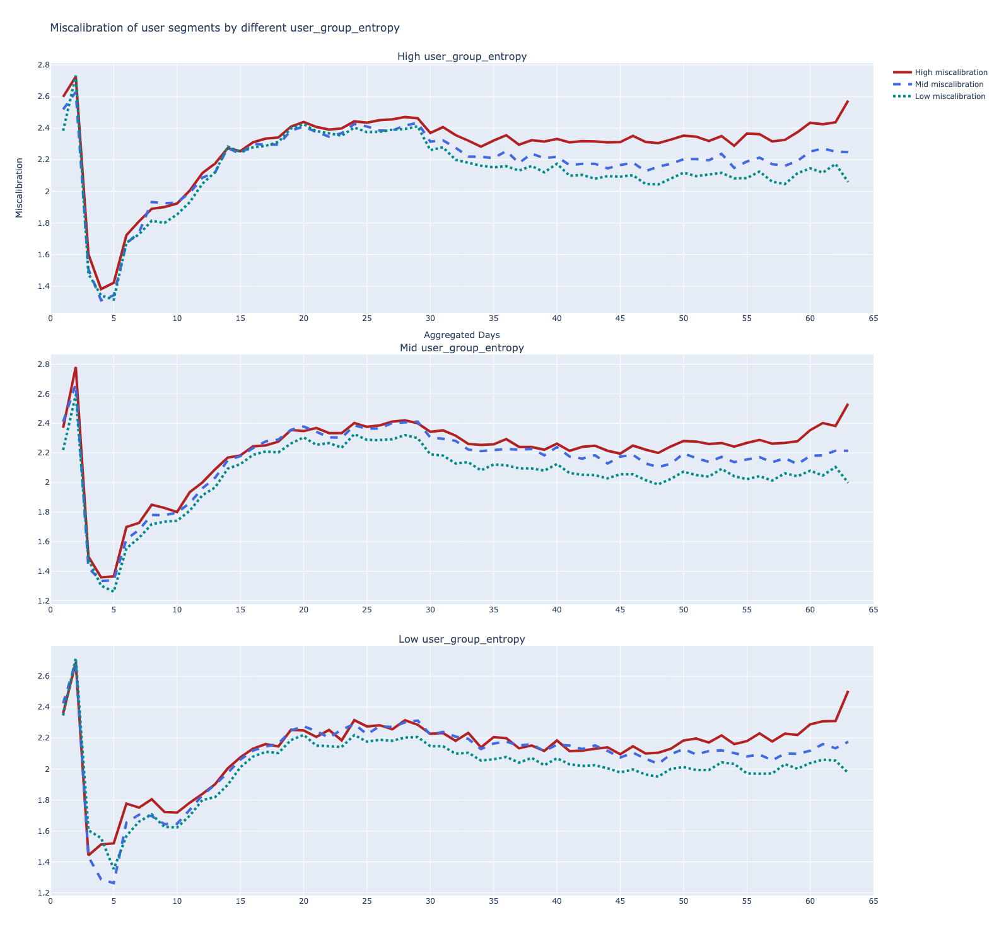

In [197]:
# change from one viz to subplotly. 
# subplot by differenet segments
colors = ['firebrick', 'royalblue', 'darkcyan']
dash = ['solid', 'dash', 'dot'] 
markers = ['circle-open-dot', 'asterisk-open', 'hash-open-dot']
lines_cat = 'miscalibration' # GROUP NAME
lines = [f"{_line} {lines_cat}" for _line in ['High', 'Mid', 'Low']]
legends = [True, False, False]

fig = make_subplots(
    rows = 3, cols=1,
    subplot_titles=[f"{i} {SEGMENT_COL}" for i in ['High','Mid','Low']],
    vertical_spacing= 0.05
)

for plot_row, seg_index in zip(range(1,4), reversed(range(1, 4))): # user segment in this subplots
    df_mean_groups = DF_MEAN_GROUP[DF_MEAN_GROUP[SEGMENT_COL]==seg_index]
    for line_index, group_index in zip(range(3),reversed(range(1, 4))):#order from high to low group value
        df_mean_group = df_mean_groups[df_mean_groups[GROUP_COL]==group_index]
        fig.add_trace(go.Scatter(
            x=df_mean_group['DataIndex'], # x-axis
            y=df_mean_group['value'], # y-axis
            #mode='lines+markers', # Connect data points with lines and add markers
            mode='lines',
            name=f"{lines[line_index]}", # Name in the legend

            #marker=dict(
            #    symbol=markers[i],    # Change the marker symbol to a circle
            #    size=8,            # Set the marker size
            #    color=colors[i]),       # Set the marker color

            line=dict(
                color=colors[line_index],        # Change the line color to red
                width=4, 
                dash=dash[line_index]),             # Set the line width
            showlegend = legends[plot_row-1],
        ), row=plot_row, col=1, )
        

fig.update_layout(
    height=1500, width=1300, 
    title=f'Miscalibration of user segments by different {SEGMENT_COL}', # Title
    xaxis_title='Aggregated Days', # y-axis name
    yaxis_title='Miscalibration', # x-axis name
    #xaxis_tickangle=45,  # Set the x-axis label angle
    showlegend=True,     # Display the legend
    xaxis = dict(
        tickmode = 'linear',
        dtick =5,
        range=[0,65]
        
    ),
    xaxis2 = dict(
        tickmode = 'linear',
        dtick =5,
        range=[0,65]
    ),
    xaxis3 = dict(
        tickmode = 'linear',
        dtick =5,
        range=[0,65]
    )
)    

# [appendix]

In [12]:
import pickle
with open('cal_features_kuairec.pickle', 'wb') as handle:
    pickle.dump(calibration_comparison_1D_multi, handle, protocol=pickle.HIGHEST_PROTOCOL)

with open('cal_features_kuairec.pickle', 'rb') as handle:
    calibration_comparison_1D_multi = pickle.load(handle)

ValueError: The truth value of a DataFrame is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().